In [9]:
%load_ext autoreload
%autoreload 2
%matplotlib widget
# %matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import torch
from CIA.ic import MovingAverage, Interpolator, ICRes
from ic.app import Config
from ic.plot import plot_piano_roll, express_to_suplot, get_colors, plot_entr, plot_metric
import matplotlib.pyplot as plt
from pathlib import Path
from pretty_midi import PrettyMIDI
from plotly.subplots import make_subplots
import plotly.express as px
import numpy as np
import IPython.display
import copy

In [5]:
!ls -t out | head -2

0933e4958227b0c28e725a149c21088f6146086314ee3d2acc719a4e4fca262e
654330513215b5e03fbcf99e31d2826dc76de6fc4c2241739b335e3ff76ab04d


In [3]:
# file = Path('out/experiment-time-points-generator-fixedsteptimepoints-step-0-5-eval-step-0-05-weight-movingaverage-window-size-2-0-c-1-0-channel-weight-1-07-0-3-0-45-0-73-dataset-datapiece-batik-ic-curve-none-match-metric-ic/samplingconfig-k-traces-16-temperature-1-0/kv331_1_start_-45_nodes_269/temp/')
file = Path('out/654330513215b5e03fbcf99e31d2826dc76de6fc4c2241739b335e3ff76ab04d/samplingconfig-k-traces-16-temperature-1-0/kv331_1_start_-45_nodes_269/0/')
result = ICRes.load(file.joinpath('ic.pt'))
ts, ics = result.timepoints, result.ic_tok


$$
\begin{align}
IC_{int}(t, \mathbf{x}) &= \sum_{i : t_i < t}
    \lambda \left(t, i \right) \cdot IC\left(x_i \vert x_{<i} \right)\\
    &= \sum_{i : t_i < t}
    a_i e ^{-b \left(t - t_{i}\right)}
    \cdot IC\left(x_i \vert x_{<i} \right)\\
\end{align}
$$

$a$ is a token information weight

$b$ is a information weight decay 

Text(0, 0.5, 'IC')

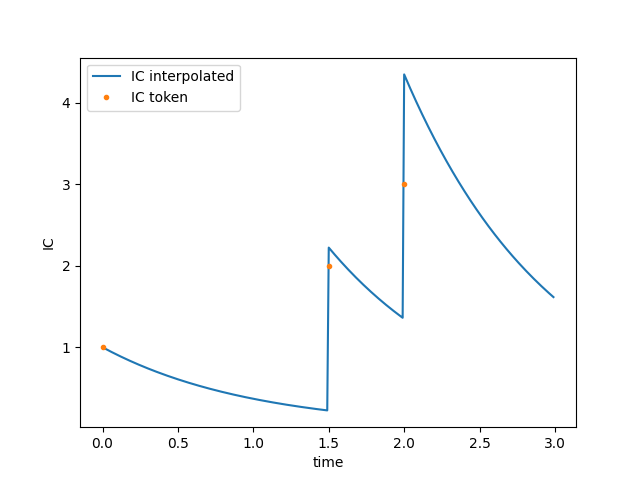

In [10]:
t = torch.tensor([0, 1.5, 2.0]) 
ic = torch.tensor([1.0, 2.0, 3.0])
grid = torch.arange(0, 3, .01)
a = 1.0
b = 1.0
cut_off = 400
weighter = MovingAverage(
    window_size = cut_off,
    decay = [b],
    channel_weight = [a]
)

ic_curve = Interpolator(
    metric_times=[t[:, None]],
    metric=[ic[:, None]],
    weight_fn=weighter
)
ic_dev = ic_curve(grid[None])
fig, ax = plt.subplots()
ax.plot(grid, ic_dev[0], '-')
ax.plot(t, ic, '.')
ax.legend(['IC interpolated','IC token'])
ax.set_xlabel('time')
ax.set_ylabel('IC')
# ax.set_title(r'$IC_{time}(t, \mathbf{x}) = \sum_{f\left(i, \mathbf{x} \right) < t}\lambda \left(t - f\left(i, \mathbf{x} \right), i \right) \cdot IC\left(x_i \vert x_{<i} \right)$')

In [11]:

parms = [
    # dict(
    #     window_size = 40,
    #     decay = [5.0],
    #     channel_weight = [
    #         1.07,
    #         0.30,
    #         0.45,
    #         0.73
    #     ]
    # ),
    # dict(
    #     window_size = 40,
    #     decay = [0.7],
    #     channel_weight = [
    #         1.07,
    #         0.30,
    #         0.45,
    #         0.73
    #     ]
    # ),
    # dict(
    #     window_size = 1.0,
    #     decay = [0.0],
    #     channel_weight = [
    #         1.07,
    #         0.30,
    #         0.45,
    #         0.73
    #     ]
    # ),
    dict(
        window_size = 4.0,
        decay = [0.2],
        channel_weight = [
            1.07,
            0.0,
            0.0,
            0.73
        ]
    )
]

for p in parms:
    sr = 10
    midi = PrettyMIDI(str(file.joinpath('song.mid')))
    piano_roll = midi.get_piano_roll(sr).T

    weighter = MovingAverage(
        **p
    )
    ic_curve = Interpolator(
        metric_times=[ts],
        metric=[ics],
        weight_fn=weighter

    )
    inpaint_time = (result.timepoints[0].min().item(), result.inpaint_end)
    times_int_summed = torch.arange(*inpaint_time, .1)
    ic_int = ic_curve(times_int_summed[None])[0]
    metric =  'Ic'
    titles = [
        'Piano Roll',
        # 'Entropy',
        f'{metric} tokens',
        f'{metric} Interpolation',
        f'{metric} Interpolation summed channels'
    ]
   # + [f'{metric} Deviation']

    fig_plotly = make_subplots(
        rows=4,
        cols=1,
        shared_xaxes=True,
        vertical_spacing=0.03,
        subplot_titles=titles,
    )
    plot_piano_roll(fig_plotly, 1, sr, piano_roll, inpaint_time)
        
    n_points = len(result.timepoints)
    # features = np.array(dataloader_generator.features)
    # features = result.ic_tok.shape[-1]
    features = np.array(['pitch', 'velocity', 'duration', 'time_shift'])
    colors_tok, colors_int = get_colors(features, n_points, ic_int.shape[0])
    times_tok = result.timepoints.flatten()
    # times_int_summed = result.timepoints_int
    times_int = np.broadcast_to(times_int_summed[:,None], ic_int.shape)

    entr = result.entr_tok.numpy().flatten()
    # plot_entr(fig_plotly, colors_tok, times_tok, entr, 2)  
    metric = result.ic_tok.numpy().flatten()
    plot_metric(metric, '', fig_plotly, colors_tok, times_tok, 2)
    express_to_suplot(fig_plotly, px.line(x=times_int.flatten(), y=ic_int.flatten(), color=colors_int, line_shape='hv', labels=dict(x="Time", y='Ic', color="Channel")), row=3, col=1)
    int_summed_channels = ic_int.sum(-1)
    express_to_suplot(fig_plotly, px.line(x=times_int_summed, y=int_summed_channels, line_shape='hv', labels=dict(x="Time", y='Ic', color="Channel")), row=4, col=1)
    break
audio_sr = 44100
crop_end_time = 180
crop_start_time = 0
croped = copy.deepcopy(midi)
croped.instruments[0].notes = [n for n in  croped.instruments[0].notes if n.end < crop_end_time]
IPython.display.display(IPython.display.Audio(croped.fluidsynth(fs=audio_sr), rate=audio_sr))
scale = 1.0
# fig_plotly.update_xaxes(tickformat="%M:%S.%3f")
# fig_plotly.update_xaxes(hoverformat="%M:%S.%3f")
fig_plotly.update_layout(height=round(1200*scale), width=round(2150*scale), xaxis=dict(range=[crop_start_time, crop_end_time])
, xaxis_tickformat="%M:%S",
) 
fig_plotly.show()


fluidsynth: error: Unknown integer parameter 'synth.sample-rate'
